In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from IPython.display import Image
import imageio
from pathlib import Path

import embeddings
import clustering
import plotting
from IPython.display import Image
import numpy as np
import pickle

### Set up

In [8]:
DATA_PATH = Path('/media/neuroscout-data/neuroscout/file_data/stimuli/')
# Save intermediary

In [3]:
frames = pd.read_csv('/media/neuroscout-data/neuroscout/datasets/raw/ds001510/stimuli/all_frames.csv')
frame_paths = [str(DATA_PATH / Path(p).parts[-1]) for p in frames.path.unique()]

### Detect faces

In [133]:
# Load data
images_50, paths_50 = embeddings.load_detect_crop(frame_paths, minsize=50)

W0821 14:08:18.806611 139932007536448 deprecation_wrapper.py:119] From /home/alejandro/repos/face_priming/src/facenet/facenet/src/align/detect_face.py:280: The name tf.variable_scope is deprecated. Please use tf.compat.v1.variable_scope instead.

W0821 14:08:18.808264 139932007536448 deprecation_wrapper.py:119] From /home/alejandro/repos/face_priming/src/facenet/facenet/src/align/detect_face.py:281: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0821 14:08:18.825745 139932007536448 deprecation_wrapper.py:119] From /home/alejandro/repos/face_priming/src/facenet/facenet/src/align/detect_face.py:125: The name tf.get_variable is deprecated. Please use tf.compat.v1.get_variable instead.

W0821 14:08:18.827878 139932007536448 deprecation.py:506] From /home/alejandro/anaconda3/envs/tf_gpu_10/lib/python3.7/site-packages/tensorflow/python/ops/init_ops.py:1251: calling VarianceScaling.__init__ (from tensorflow.python.ops.init_ops) with dtype is deprecated a

Creating networks and loading parameters


W0821 14:08:18.967213 139932007536448 deprecation.py:323] From /home/alejandro/repos/face_priming/src/facenet/facenet/src/align/detect_face.py:213: div (from tensorflow.python.ops.math_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Deprecated in favor of operator or tf.math.divide.
W0821 14:08:19.547630 139932007536448 deprecation_wrapper.py:119] From /home/alejandro/repos/face_priming/src/facenet/facenet/src/align/detect_face.py:197: The name tf.nn.xw_plus_b is deprecated. Please use tf.compat.v1.nn.xw_plus_b instead.



Loading, cropping, and aligning


In [134]:
len(images_50)

2587

### Get embeddings

In [135]:
embs_50 = embeddings.get_embeddings(images_50)

Model directory: /home/alejandro/repos/face_priming/models/20180402-114759
Metagraph file: model-20180402-114759.meta
Checkpoint file: model-20180402-114759.ckpt-275
Calculating embeddings...


In [20]:
save_path = Path('/media/neuroscout-data/scratch/face_priming_save/')
# pickle.dump(embs_50, (save_path / 'struct_embs_50.pkl').open('wb'))
# pickle.dump(paths_50, (save_path / 'struct_paths_50.pkl').open('wb'))
# pickle.dump(
#     images_50, (save_path / 'struct_cropped_images_50.pkl').open('wb'), 
#     protocol=4)

embs_50 = pickle.load((save_path / 'struct_embs_50.pkl').open('rb'))
paths_50 = pickle.load((save_path / 'struct_paths_50.pkl').open('rb'))
images_50 = pickle.load(
    (save_path / 'struct_cropped_images_50.pkl').open('rb'))

### Cluster images

In [137]:
clusters50_59 = clustering.chinese_whispers(paths_50, images_50, embs_50, threshold=0.59)

'plots/struct_cw_t_059_min50.png'

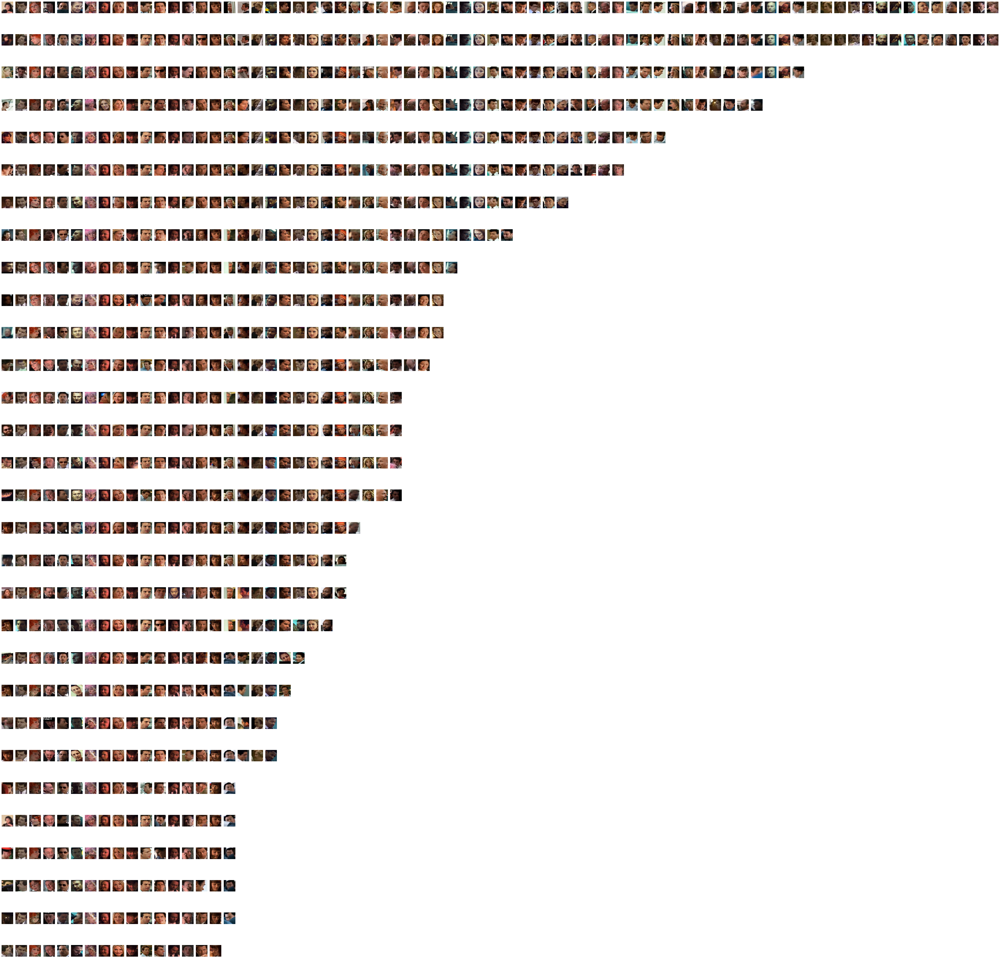

In [138]:
plotting.plot_clusters(clusters50_59, n_sample=30, figsize=(80, 80), outfile='plots/struct_cw_t_059_min50.png')

In [5]:
clusters50_68 = clustering.chinese_whispers(paths_50, images_50, embs_50, threshold=0.68)

In [13]:
pickle.dump(clusters50_68, (save_path / 'struct_clusters50_68.pkl').open('wb'))

'plots/struct_cw_t_068_min50_first25.png'

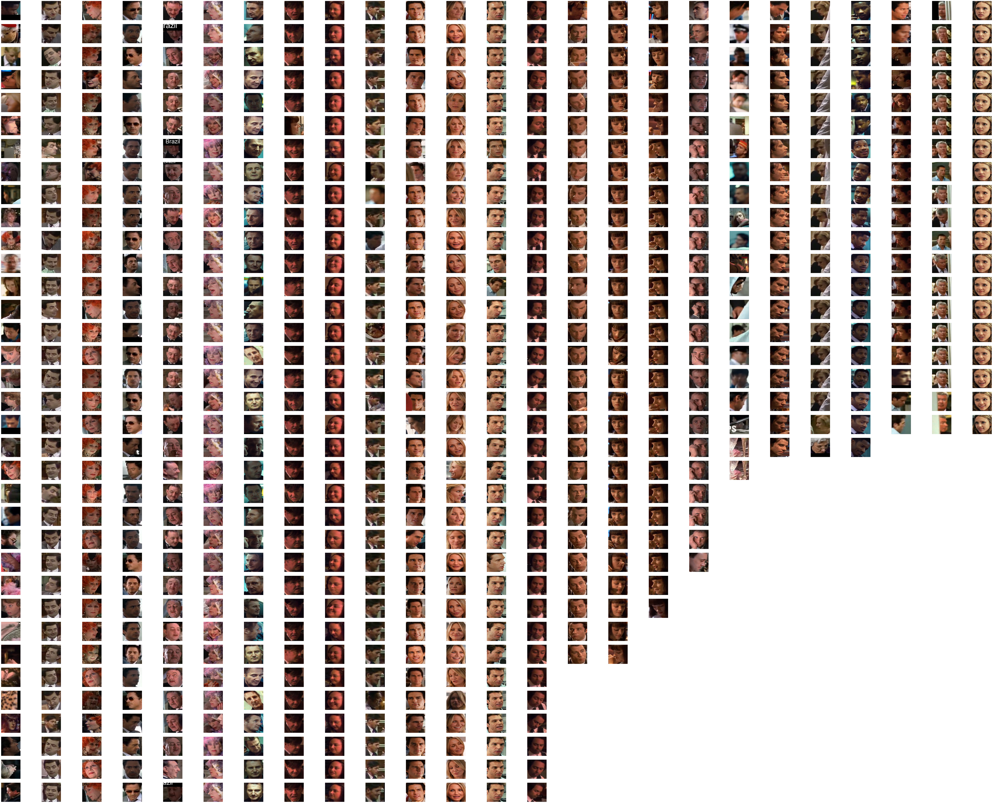

In [140]:
plotting.plot_clusters(clusters50_68[:25], n_sample=35, figsize=(110, 90), outfile='plots/struct_cw_t_068_min50_first25.png')

# Create predictors

In [12]:
clusters50_68 = pickle.load((save_path / 'struct_clusters50_68.pkl').open('rb'))

1. Face detection 
2. For chosen solution, predictors for all clusters (or maybe only clusters w/ x number?
3. New face detection (first second face in cluster)
4. Time since last presentation (log transformed)
5. Total onscreen time (log transformed) (for each predictor, then take average across)

## Fine grained face detection

In [36]:
from importlib import reload
import regressors
import datetime
import pyns

In [37]:
from regressors import _face_detection, _compute_time_dependent, _calc_running_time, _first_time, _get_wide_cluster_ids, _get_face_times

In [38]:
api = pyns.Neuroscout()

In [39]:
frames['cond'] = frames.apply(lambda x: str(x['subject_id']) + "_" + str(x['run_number']), axis=1)

In [40]:
# output = regressors.prepare_regressors(frames, paths_50, clusters50_68, bad_clusters=[1])?

In [41]:
paths = paths_50
clusters = clusters50_68
bad_clusters=[1]

In [42]:
# Do face detection
face_detection = _face_detection(paths)
output = pd.merge(frames, face_detection, how='outer')

In [43]:
output = output.sort_values(['subject_id', 'run_number'])

In [44]:
cluster_ids_wide = _get_wide_cluster_ids(clusters)
# Merge face IDs into main file
output = pd.merge(output, cluster_ids_wide, how='outer')
output = output.sort_values(['subject_id', 'run_number', 'onset']).reset_index().drop(columns='index')

In [45]:
all_faces = ["id_" + str(i) for i in range(1, len(clusters) + 1)]
for bad in bad_clusters:
    all_faces.remove(f"id_{bad}")

In [35]:
output = output.groupby('subject_id').apply(_compute_time_dependent, all_faces)

KeyboardInterrupt: 

In [220]:
output['log_mean_time_since'] = np.log(output.mean_time_since)
output['log_mean_face_time_cum'] = np.log(output.mean_face_time_cum)
output['log_max_time_since'] = np.log(output.max_time_since)
output['log_max_face_time_cum'] = np.log(output.max_face_time_cum)

Note: Face detection works fine, but because we are excluding cluster 1 (noise cluster), and in some frames multiple faces are detected and put into cluster 1, they will not be counted in the other statistics

In [60]:
# select = output[['cond', 'subject_id', 'run_number', 'onset', 'duration', 'face_count', 'any_faces', 
#                 'first_time_face', 'log_mean_time_since', 'log_max_time_since', 
#                  'log_mean_face_time_cum', 'log_max_face_time_cum']]
top_faces = output[['cond', 'subject_id', 'run_number', 'onset', 'duration'] + [f"id_{str(i)}" for i in range(1, 21)]]
event_files = []
ids = []
for i, x in top_faces.groupby('cond'):
    subject_id = x.iloc[0].subject_id
    run_number = x.iloc[0].run_number
    df = x.drop(columns=['run_number', 'subject_id'])
    fname = f'/home/alejandro/datasets/raw/ds001510/stimuli/facenet/facenet_min50_t59_topfaces_subject_{subject_id}_run_{run_number}.tsv'
    df.to_csv(fname, sep='\t', index=False)
    event_files.append(fname)
    ids.append((subject_id, run_number))

In [72]:
event_files

['/home/alejandro/datasets/raw/ds001510/stimuli/facenet/facenet_min50_t59_topfaces_subject_10_run_1.tsv',
 '/home/alejandro/datasets/raw/ds001510/stimuli/facenet/facenet_min50_t59_topfaces_subject_10_run_2.tsv',
 '/home/alejandro/datasets/raw/ds001510/stimuli/facenet/facenet_min50_t59_topfaces_subject_10_run_3.tsv',
 '/home/alejandro/datasets/raw/ds001510/stimuli/facenet/facenet_min50_t59_topfaces_subject_10_run_4.tsv',
 '/home/alejandro/datasets/raw/ds001510/stimuli/facenet/facenet_min50_t59_topfaces_subject_11_run_1.tsv',
 '/home/alejandro/datasets/raw/ds001510/stimuli/facenet/facenet_min50_t59_topfaces_subject_11_run_2.tsv',
 '/home/alejandro/datasets/raw/ds001510/stimuli/facenet/facenet_min50_t59_topfaces_subject_11_run_3.tsv',
 '/home/alejandro/datasets/raw/ds001510/stimuli/facenet/facenet_min50_t59_topfaces_subject_11_run_4.tsv',
 '/home/alejandro/datasets/raw/ds001510/stimuli/facenet/facenet_min50_t59_topfaces_subject_12_run_1.tsv',
 '/home/alejandro/datasets/raw/ds001510/stimul

### Upload

In [61]:
import pyns

In [62]:
descriptions = {
}

In [63]:
dataset_id = 20

In [64]:
run_ids = [[api.runs.get(dataset_id=dataset_id, subject=str(s).zfill(2), number=r)[0]['id']] for (s, r) in ids]

In [79]:
pd.read_table(event_files[3]).max()

/home/alejandro/anaconda3/envs/tf_gpu_10/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: read_table is deprecated, use read_csv instead, passing sep='\t'.
  """Entry point for launching an IPython kernel.


cond        104.00
onset       729.56
duration      1.00
id_1          1.00
id_2           NaN
id_3          1.00
id_4          1.00
id_5          1.00
id_6          1.00
id_7          1.00
id_8           NaN
id_9           NaN
id_10          NaN
id_11          NaN
id_12          NaN
id_13          NaN
id_14          NaN
id_15         1.00
id_16          NaN
id_17         1.00
id_18         1.00
id_19          NaN
id_20         1.00
dtype: float64

In [65]:
api.predictors.create_collection(
    'semanticnarrative_facenet_cw_min50_t68_topfaces', dataset_id, run_ids, event_files, descriptions)

{'collection_name': 'semanticnarrative_facenet_cw_min50_t68_topfaces',
 'id': 35,
 'predictors': [],
 'status': 'PENDING',
 'traceback': None,
 'uploaded_at': '2019-09-13T17:5'}

In [73]:
api.predictors.get_collection(35)

{'collection_name': 'semanticnarrative_facenet_cw_min50_t68_topfaces',
 'id': 35,
 'predictors': [{'id': 19754, 'name': 'id_3'},
  {'id': 19755, 'name': 'id_4'},
  {'id': 19756, 'name': 'id_6'},
  {'id': 19757, 'name': 'id_8'},
  {'id': 19758, 'name': 'id_12'},
  {'id': 19759, 'name': 'cond'},
  {'id': 19760, 'name': 'id_9'},
  {'id': 19761, 'name': 'id_1'},
  {'id': 19762, 'name': 'id_20'},
  {'id': 19763, 'name': 'id_15'},
  {'id': 19764, 'name': 'id_10'},
  {'id': 19765, 'name': 'id_16'},
  {'id': 19766, 'name': 'id_19'},
  {'id': 19767, 'name': 'id_5'},
  {'id': 19768, 'name': 'id_13'},
  {'id': 19769, 'name': 'id_17'},
  {'id': 19770, 'name': 'id_18'},
  {'id': 19771, 'name': 'id_14'},
  {'id': 19772, 'name': 'id_11'},
  {'id': 19773, 'name': 'id_7'},
  {'id': 19774, 'name': 'id_2'}],
 'status': 'OK',
 'traceback': None,
 'uploaded_at': '2019-09-13T17:5'}